NameError: name 't_set_new1' is not defined

True
MAX_ITER: 50
Trajectory ['traj_13', 'traj_14']
Yaw_mode 0
Initializing dataset
Start generating initial trajectory
Done generating initial trajectory
Start training model
Epoch 1/500 - Loss: 0.004
Epoch 20/500 - Loss: 0.003
Epoch 40/500 - Loss: 0.002
Epoch 60/500 - Loss: 0.001
Epoch 80/500 - Loss: 0.001
Epoch 100/500 - Loss: 0.001
Epoch 120/500 - Loss: 0.001
Epoch 140/500 - Loss: 0.001
Epoch 160/500 - Loss: 0.001
Epoch 180/500 - Loss: 0.001
Epoch 200/500 - Loss: 0.001
Epoch 220/500 - Loss: 0.001
Epoch 240/500 - Loss: 0.001
Epoch 260/500 - Loss: 0.001
Epoch 280/500 - Loss: 0.001
Epoch 300/500 - Loss: 0.001
Epoch 320/500 - Loss: 0.001
Epoch 340/500 - Loss: 0.001
Epoch 360/500 - Loss: 0.001
Epoch 380/500 - Loss: 0.001
Epoch 400/500 - Loss: 0.001
Epoch 420/500 - Loss: 0.001
Epoch 440/500 - Loss: 0.001
Epoch 460/500 - Loss: 0.001
Epoch 480/500 - Loss: 0.001
Epoch 500/500 - Loss: 0.001
 - Time: 79.834
Epoch 1/500 - Loss: 0.004
Epoch 20/500 - Loss: 0.003
Epoch 40/500 - Loss: 0.002
Epoch 

False


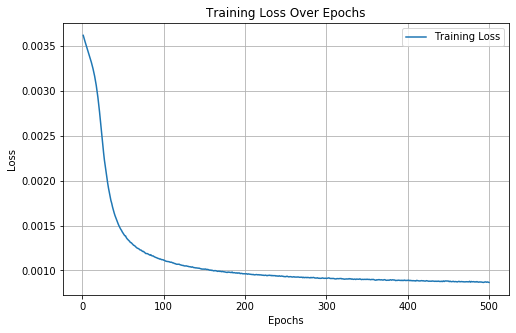

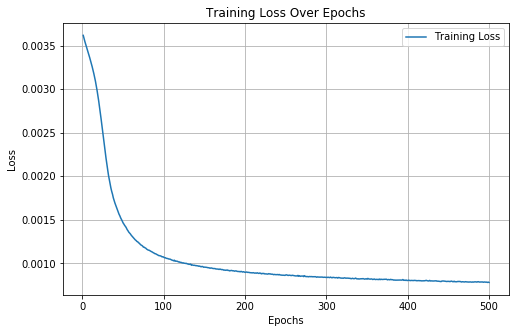

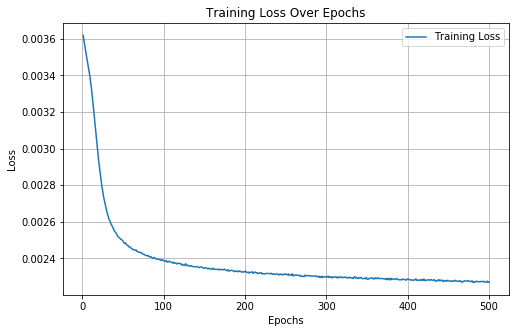

In [8]:
#!/usr/bin/env python
# coding: utf-8
%tb
import os
import numpy as np
import argparse
import torch
import matplotlib

import matplotlib.pyplot as plt

from pyTrajectoryUtils.pyTrajectoryUtils.utils import *
from mfboTrajectory.utils import *
from mfboTrajectory.agents_two_drones import ActiveMFDGP, TwoDrone
from mfboTrajectory.minSnapTrajectoryPolytopes import MinSnapTrajectoryPolytopes
from mfboTrajectory.multiFidelityModelPolytopes import get_waypoints_plane, meta_low_fidelity, get_dataset_init, check_dataset_init, meta_low_fidelity_multi, get_dataset_init_multi
from mfboTrajectory.utilsConvexDecomp import *


if __name__ == "__main__":
    sample_name = [['traj_13', 'traj_14']]
    drone_model = "default"
    
    rand_seed = [123, 445, 678, 115, 92, 384, 992, 874, 490, 41, 83, 78, 991, 993, 994, 995, 996, 997, 998, 999]
    max_col_err = 0.03 
    N_trial=3  # number of consecutive successful flights needed to be considered valid (used in sanity_check)
    # Create the folder if it doesn't exist
    data_folder = 'data'
    if not os.path.exists(data_folder):
        os.makedirs(data_folder)
    args = argparse.Namespace(train_model=True, optimize_alpha=False, generate_dataset=False, use_sim=False, sample_idx=0, seed_idx=0, max_iter=50, yaw_mode=0, qp_optimizer="osqp")
    print(args.train_model)
    if not args.train_model:
        # Force optimize_alpha and generate_dataset to be true if plot is true to preload all data
        args.optimize_alpha = False
        args.generate_dataset = False
    if not args.generate_dataset:
        args.optimize_alpha = False
    
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  # use gpu if available
    torch.autograd.set_detect_anomaly(True)
    
    # PARSE ARGPARSE
    # select optimizer
    qp_optimizer = args.qp_optimizer.lower()
    assert qp_optimizer in ['osqp', 'gurobi','cvxopt']
    
    yaw_mode = args.yaw_mode
    sample_name_ = sample_name[args.sample_idx]
    rand_seed_ = rand_seed[args.seed_idx]
    max_iter = np.int(args.max_iter)
    print(f"MAX_ITER: {max_iter}")
    
    print(f"Trajectory {sample_name_}")
    polygon_filedir = './constraints_data'
    polygon_filename = 'polytopes_constraints.yaml'
    
    poly = MinSnapTrajectoryPolytopes(drone_model=drone_model, yaw_mode=yaw_mode, qp_optimizer=qp_optimizer)
    
    # get info about polytope constraints
    # plane_pos_set = list of dicts of polytopes, each dict includes list of faces ("constraint planes") and input and/or output plane
    # points = waypoints generated from polytopes (??), includes midpoint of input/output planes
    # t_set_sta = initial time allocation per segment
    points1, plane_pos_set1, t_set_sta1, waypoints1 = get_waypoints_plane(polygon_filedir, polygon_filename, sample_name_[0], flag_t_set=True)
    points2, plane_pos_set2, t_set_sta2, waypoints2 = get_waypoints_plane(polygon_filedir, polygon_filename, sample_name_[1], flag_t_set=True)
    
    lb = 0.1
    ub = 1.9
    
    print("Yaw_mode {}".format(yaw_mode))
    if t_set_sta1.shape[0] != t_set_sta2.shape[0]:
        print("Time allocation mismatch")
        exit()
    
    t_dim = t_set_sta1.shape[0]
    lb_i = np.ones(t_dim)*lb
    ub_i = np.ones(t_dim)*ub

    
    print("Initializing dataset")
    if args.use_sim:
        sanity_check_t = lambda t_set, d_ordered, d_ordered_yaw: \
            poly.run_sim_loop(t_set, d_ordered, d_ordered_yaw, plane_pos_set1, max_col_err=max_col_err, N_trial=N_trial)
    else:
        sanity_check_t = None
    print("Start generating initial trajectory")
    t_set_sta1, d_ordered1, d_ordered_yaw1 = poly.update_traj(t_set_sta1, 
                                                            points1, 
                                                            plane_pos_set1, 
                                                            waypoints1,
                                                            np.ones_like(t_set_sta1),
                                                            flag_fixed_point=False,
                                                            flag_fixed_end_point=False)
    
    t_set_sta2, d_ordered2, d_ordered_yaw2 = poly.update_traj(t_set_sta2, 
                                                            points2, 
                                                            plane_pos_set2, 
                                                            waypoints2,
                                                            np.ones_like(t_set_sta2),
                                                            flag_fixed_point=False, 
                                                            flag_fixed_end_point=False)
    # ensure time allocations match (eq 28)
    # note: for 13 and 14, time allocations always match (both are [5, 10, 10, 5])
    if not np.array_equal(t_set_sta1, t_set_sta2):
        print("scaling time arrays")
        waypoints_idx = np.where(waypoints1)[0]  # waypoints are the same between both files

        for idx in range(len(waypoints_idx)-1):
            sum_xij1 = sum(t_set_sta1[waypoints_idx[idx]:waypoints_idx[idx+1]])
            sum_xij2 = sum(t_set_sta2[waypoints_idx[idx]:waypoints_idx[idx+1]])

            scaled1 = np.array(t_set_sta1[waypoints_idx[idx]:waypoints_idx[idx+1]]) * (2*sum_xij2) / (sum_xij1 + sum_xij2)
            scaled2 = np.array(t_set_sta2[waypoints_idx[idx]:waypoints_idx[idx+1]]) * (2*sum_xij1) / (sum_xij1 + sum_xij2)

            t_set_sta1[waypoints_idx[idx]:waypoints_idx[idx+1]] = list(scaled1)
            t_set_sta2[waypoints_idx[idx]:waypoints_idx[idx+1]] = list(scaled2)

    # save data to files
    print("Done generating initial trajectory")
    if args.optimize_alpha:
        print("Start generating time optimized trajectory")
        t_set_sim1, d_ordered1, d_ordered_yaw1, alpha_sim1 = poly.optimize_alpha(points1,  
                                                                                t_set_sta1,  # initial time array
                                                                                d_ordered1,  # initial position array
                                                                                d_ordered_yaw1,  # initial yaw angle array
                                                                                alpha_scale=1.0,  # alpha scaling
                                                                                sanity_check_t=sanity_check_t,  # sim env to check valid trajectory
                                                                                flag_return_alpha=True,  # returns alpha value if true
                                                                                )

        t_set_sim2, d_ordered2, d_ordered_yaw2, alpha_sim2 = poly.optimize_alpha(points2,  
                                                                                t_set_sta2,  # initial time array
                                                                                d_ordered2,  # initial position array
                                                                                d_ordered_yaw2,  # initial yaw angle array
                                                                                alpha_scale=1.0,  # alpha scaling
                                                                                sanity_check_t=sanity_check_t,  # sim env to check valid trajectory
                                                                                flag_return_alpha=True,  # returns alpha value if true
                                                                                )

        print("alpha_sim Drone 2: {}".format(alpha_sim2))

        # ENFORCE EQUAL SCALING
        if alpha_sim1 != alpha_sim2:
            print("scaling alphas")
            alpha_sim1 = max(alpha_sim1, alpha_sim2)
            alpha_sim2 = max(alpha_sim1, alpha_sim2)
            
            N_wp = np.int(d_ordered1.shape[0]/poly.N_DER) # num waypoints

            t_set_sta1 = t_set_sta1 * alpha_sim1  # times scaled by alpha (??)
            t_set_sta2 = t_set_sta2 * alpha_sim2  # times scaled by alpha (??)
            
            # scale d ordered by alpha
            d_ordered1 = poly.get_alpha_matrix(alpha_sim1, N_wp).dot(d_ordered1)  # list of positions
            if np.all(d_ordered_yaw1 != None):  # list of yaw angles
                d_ordered_yaw1 = poly.get_alpha_matrix_yaw(alpha_sim1,N_wp).dot(d_ordered_yaw1)
            else:
                d_ordered_yaw1 = None

            d_ordered2 = poly.get_alpha_matrix(alpha_sim1, N_wp).dot(d_ordered2)  # list of positions
            if np.all(d_ordered_yaw2 != None):  # list of yaw angles
                d_ordered_yaw2 = poly.get_alpha_matrix_yaw(alpha_sim2,N_wp).dot(d_ordered_yaw2)
            else:
                d_ordered_yaw2 = None
        print("alpha_sim Drone 1: {}".format(alpha_sim1))
        # Save the data to the file in the data folder
        with open(os.path.join(data_folder, f"optimize_alpha_{sample_name_[0]}.npy"), "wb") as f:
            np.save(f, t_set_sim1)
            np.save(f, d_ordered1)
            np.save(f, d_ordered_yaw1)
            np.save(f, np.array(alpha_sim1))
            
        # save data to files
        with open(os.path.join(data_folder, f"optimize_alpha_{sample_name_[1]}.npy"), "wb") as f:
            np.save(f, t_set_sim2)
            np.save(f, d_ordered2)
            np.save(f, d_ordered_yaw2)
            np.save(f, np.array(alpha_sim2))
    else:
        with open(os.path.join(data_folder, f"optimize_alpha_{sample_name_[0]}.npy"), "rb") as f:
            t_set_sim1 = np.load(f)
            d_ordered1_sim = np.load(f)
            d_ordered_yaw1_sim = np.load(f)
            alpha_sim1 = np.load(f)
        with open(os.path.join(data_folder, f"optimize_alpha_{sample_name_[1]}.npy"), "rb") as f:
            t_set_sim2 = np.load(f)
            d_ordered2_sim = np.load(f)
            d_ordered_yaw2_sim = np.load(f)
            alpha_sim2 = np.load(f)
    
        
    low_fidelity1 = lambda x, debug=True, multicore=False: \
        meta_low_fidelity(poly, x, t_set_sta1, points1, plane_pos_set1, waypoints1, debug, lb=lb, ub=ub, multicore=multicore)
    low_fidelity2 = lambda x, debug=True, multicore=False: \
        meta_low_fidelity(poly, x, t_set_sta2, points2, plane_pos_set2, waypoints2, debug, lb=lb, ub=ub, multicore=multicore)
    low_fidelity_multi = lambda x1, x2, debug=True, multicore=True: \
        meta_low_fidelity_multi(poly, x1, t_set_sta1, points1, plane_pos_set1, waypoints1, x2, t_set_sta2, points2, plane_pos_set2, waypoints2, debug, lb=lb, ub=ub, multicore=multicore)
    if args.generate_dataset:
        
        print("Start initializing dataset")
        X_L1, Y_L1, X_H, Y_H = get_dataset_init(sample_name_[0], 
                                                alpha_sim1, 
                                                low_fidelity1,
                                                t_dim, 
                                                N_L=1000, 
                                                N_H=2, 
                                                lb=lb, 
                                                ub=ub,
                                                sampling_mode=2, 
                                                flag_multicore=True)
        with open(os.path.join(data_folder, f"{sample_name_[0]}_init_dataset.npy"), "wb") as f:
            np.save(f, X_L1)
            np.save(f, Y_L1)
        X_L2, Y_L2, X_H, Y_H = get_dataset_init(sample_name_[1], 
                                                alpha_sim2, 
                                                low_fidelity2,
                                                t_dim, 
                                                N_L=1000, 
                                                N_H=2, 
                                                lb=lb, 
                                                ub=ub,
                                                sampling_mode=2, 
                                                flag_multicore=True)
        with open(os.path.join(data_folder, f"{sample_name_[1]}_init_dataset.npy"), "wb") as f:
            np.save(f, X_L2)
            np.save(f, Y_L2)
        X_L_all, Y_L_all = get_dataset_init_multi(sample_name_, 
                                        alpha_sim1,
                                        alpha_sim2, 
                                        low_fidelity_multi,
                                        t_dim, 
                                        N_L=2000,
                                        lb=lb, 
                                        ub=ub,
                                        sampling_mode=2, 
                                        flag_multicore=True)
        with open(os.path.join(data_folder, f"{sample_name_[0]}_{sample_name_[1]}_init_dataset.npy"), "wb") as f:
            np.save(f, X_L_all)
            np.save(f, Y_L_all)
    else:            
        with open(os.path.join(data_folder, f"{sample_name_[0]}_init_dataset.npy"), "rb") as f:
            X_L1 = np.load(f)
            Y_L1 = np.load(f)
        with open(os.path.join(data_folder, f"{sample_name_[1]}_init_dataset.npy"), "rb") as f:
            X_L2 = np.load(f)
            Y_L2 = np.load(f)
        with open(os.path.join(data_folder, f"{sample_name_[0]}_{sample_name_[1]}_init_dataset.npy"), "rb") as f:
            X_L_all = np.load(f)
            Y_L_all = np.load(f)
    np.random.seed(rand_seed_)
    torch.manual_seed(rand_seed_)

    # filenames
    fileprefix = "test_polytopes"
    filedir = f"./mfbo_data/{sample_name_}"
    logprefix = '{sample_name_}/{fileprefix}/{rand_seed_}'
    results_filename = f'result_{fileprefix}_{rand_seed_}.yaml'
    exp_data_filename = f'exp_data_{fileprefix}_{rand_seed_}.yaml'
    
    if args.train_model:
        print("Start training model")
        two_drones = TwoDrone(
            X1 = X_L1,
            Y1 = Y_L1,
            X2 = X_L2,
            Y2 = Y_L2,
            X12 = X_L_all,
            Y12 = Y_L_all,
            lb_i = lb_i,
            ub_i = ub_i,
            beta = 3.0,
            rand_seed = rand_seed_,
            N_cand = 128,
            batch_size = 1024,
            model_prefix = logprefix,
            t_set_sim_1 = t_set_sim1,
            t_set_sim_2 = t_set_sim2,
            eval_func_1 = low_fidelity1,
            eval_func_2 = low_fidelity2,
            eval_func_12 = low_fidelity_multi,
            t_set_sta = t_set_sta1
        )

        X, Y = two_drones.bayes_opt(min_iters=200, max_iters=250)
        print("FINAL X")
        print(X)
        
        alpha_set_1 = lb + X.flatten()[range(4)] * (ub - lb)
        print(alpha_set_1)
        alpha_set_2 = lb + X.flatten()[range(4, 8)] * (ub - lb)
        t_set_1, d_ordered_1, d_ordered_yaw_1 = poly.update_traj(t_set_sta1, 
                                                                    points1, 
                                                                    plane_pos_set1, 
                                                                    waypoints1,
                                                                    alpha_set=alpha_set_1,
                                                                    flag_fixed_point=False, 
                                                                    flag_fixed_end_point=False)
        t_set_2, d_ordered_2, d_ordered_yaw_2 = poly.update_traj(t_set_sta2, 
                                                                    points2, 
                                                                    plane_pos_set2, 
                                                                    waypoints2,
                                                                    alpha_set=alpha_set_2,
                                                                    flag_fixed_point=False, 
                                                                    flag_fixed_end_point=False)
        with open(os.path.join(data_folder, f"final_{sample_name_[0]}.npy"), "wb") as f:
            np.save(f, t_set_1)
            np.save(f, d_ordered_1)
            np.save(f, d_ordered_yaw_1)
        with open(os.path.join(data_folder, f"final_{sample_name_[1]}.npy"), "wb") as f:
            np.save(f, t_set_2)
            np.save(f, d_ordered_2)
            np.save(f, d_ordered_yaw_2)
    else:
        with open(os.path.join(data_folder, f"final_{sample_name_[0]}.npy"), "rb") as f:
            t_set_1 = np.load(f)
            d_ordered_1 = np.load(f)
            d_ordered_yaw_1 = np.load(f)
        with open(os.path.join(data_folder, f"final_{sample_name_[1]}.npy"), "rb") as f:
            t_set_2 = np.load(f)
            d_ordered_2 = np.load(f)
            d_ordered_yaw_2 = np.load(f)
    print("Plotting trajectory")
    traj1, traj2 = poly.plot_trajectory_multi(t_set_1, d_ordered_1, plane_pos_set1, t_set_2, d_ordered_2, plane_pos_set2)
    sanity_check = poly.sanity_check_multi(t_set_1, d_ordered1, d_ordered_yaw1, t_set_2, d_ordered2, d_ordered_yaw2)
    print(sanity_check)


In [10]:
x, y = poly.animate_trajectory_multi(t_set_1, d_ordered1, plane_pos_set1, t_set_2, d_ordered2, plane_pos_set2)

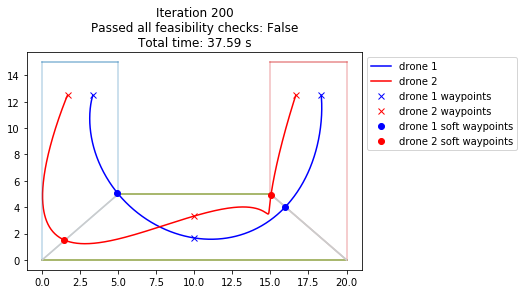

In [9]:
%matplotlib inline
plt.figure()
n=len(traj1)
h1, = plt.plot(traj1[:n, 0], traj1[:n, 1], 'b', label="drone 1")
h2, = plt.plot(traj2[:n, 0], traj2[:n, 1], 'r', label="drone 2")

# plt.plot(traj1[:, 0], traj1[:, 1], alpha=.2, color='C0')
# plt.plot(traj2[:, 0], traj2[:, 1], alpha=.2, color='C1')

# for point in points1:
#     plt.plot(point[0], point[1], 'o', color='C0')
for i, dict in enumerate(plane_pos_set1):
    for c in dict['constraints_plane']:
        h7, = plt.plot([c[0][0], c[1][0]], [c[0][1], c[1][1]], color=f"C{i}", alpha=.3, label="polytope constraints")
for i, dict in enumerate(plane_pos_set1):
    o = dict["output_plane"]
    if len(o)>0:
        h8, = plt.plot([o[0][0], o[1][0]], [o[0][1], o[1][1]], color=[.8, .8, .8], label="polytope crossings")

for idx in [0, 399, 799]:
    h3, = plt.plot(traj1[idx, 0], traj1[idx, 1], 'x', color='b', label="drone 1 waypoints")
    h4, = plt.plot(traj2[idx, 0], traj2[idx, 1], 'x', color='r', label="drone 2 waypoints")
for idx in [199, 599]:
    h5, = plt.plot(traj1[idx, 0], traj1[idx, 1], 'o', color='b', label="drone 1 soft waypoints")
    h6, = plt.plot(traj2[idx, 0], traj2[idx, 1], 'o', color='r', label="drone 2 soft waypoints")
    

plt.title(f"Iteration 200\nPassed all feasibility checks: {sanity_check}\nTotal time: {np.round(sum(t_set_1), 2)} s")
plt.legend(loc="upper left", bbox_to_anchor=(1, 1), handles=[h1, h2, h3, h4, h5, h6])
plt.show()